# Importing and locating csv files from a specified directory

In [1]:
#read in varaibles from other notebook
%store -r sensorPaths
print(sensorPaths)

{'16397': '..\\..\\data\\flow\\task_206_1629981045\\sensor_16397\\sensor_measures_20210805_20210824_1.csv', '17539': '..\\..\\data\\flow\\task_206_1629981045\\sensor_17539\\sensor_measures_20210806_20210824_1.csv', '18699': '..\\..\\data\\flow\\task_206_1629981045\\sensor_18699\\sensor_measures_20210731_20210824_1.csv'}


# Intialising the measurement dataframes

In [2]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import sys
import numpy as np
import matplotlib.dates as mdates

In [3]:
#bringing the csv to pandas dataframes
for key in sensorPaths:
    df = (pd.read_csv(sensorPaths[key],parse_dates=True, index_col="date"))
    sensorPaths[key] = df

# Initial look at the data 

## Station 1 Riyad
illustrate statistiscal properties of individual columns

In [ ]:
for key in sensorPaths:
    df = sensorPaths[key]

# Identifying null values in dataframe

In [10]:
dfList[0].isnull().sum()

timestamp            0
NO2 (ppb)            0
NO2 (Plume AQI)      0
VOC (ppb)            0
VOC (Plume AQI)      0
pm 1 (ug/m3)         0
pm 1 (Plume AQI)     0
pm 10 (ug/m3)        0
pm 10 (Plume AQI)    0
pm25 (ug/m3)         0
pm 25 (Plume AQI)    0
dtype: int64

In [11]:
dfList[1].isnull().sum()

timestamp            0
NO2 (ppb)            0
NO2 (Plume AQI)      0
VOC (ppb)            0
VOC (Plume AQI)      0
pm 1 (ug/m3)         0
pm 1 (Plume AQI)     0
pm 10 (ug/m3)        0
pm 10 (Plume AQI)    0
pm25 (ug/m3)         0
pm 25 (Plume AQI)    0
dtype: int64

In [12]:
dfList[2].isnull().sum()

timestamp            0
NO2 (ppb)            0
NO2 (Plume AQI)      0
VOC (ppb)            0
VOC (Plume AQI)      0
pm 1 (ug/m3)         0
pm 1 (Plume AQI)     0
pm 10 (ug/m3)        0
pm 10 (Plume AQI)    0
pm25 (ug/m3)         0
pm 25 (Plume AQI)    0
dtype: int64

# Data Visualisation N02


<AxesSubplot:xlabel='NO2 (ppb)'>

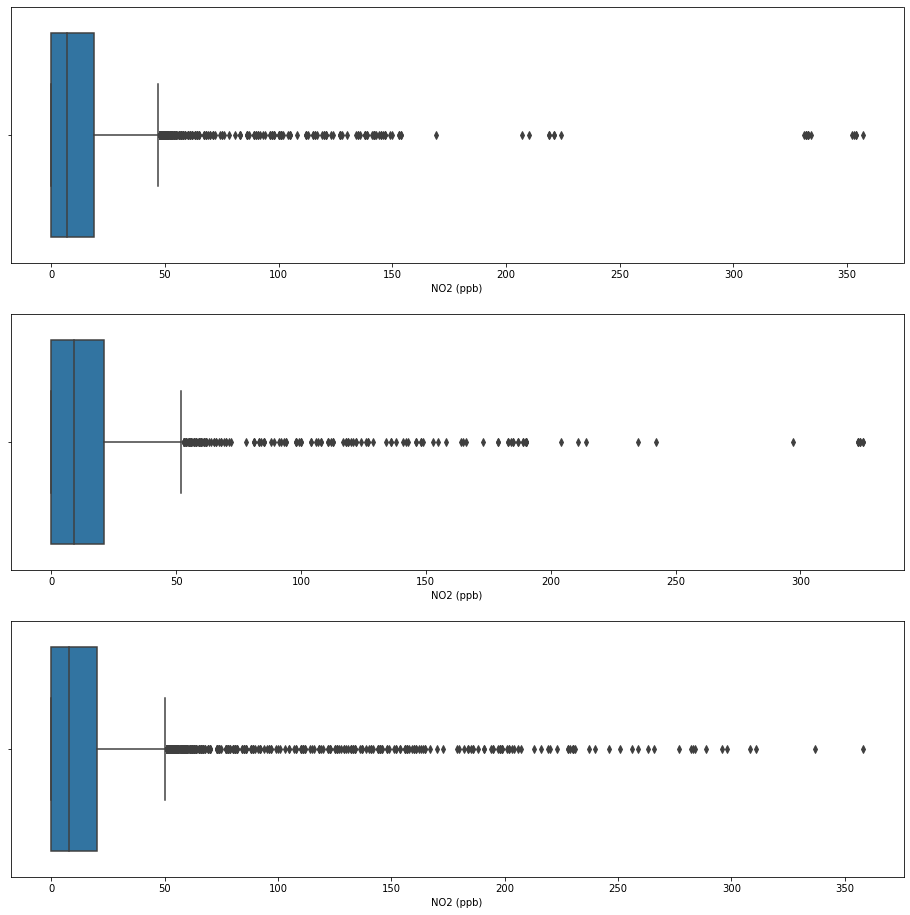

In [13]:
fig, axs = plt.subplots(3, figsize = (16,16))
sns.boxplot(x=dfList[0]['NO2 (ppb)'], ax=axs[0])
sns.boxplot(x=dfList[1]['NO2 (ppb)'], ax=axs[1])
sns.boxplot(x=dfList[2]['NO2 (ppb)'], ax=axs[2])
    #boxplot shows one outlier between 80 and 90

## Idenifying zero values
This shows the number of "0ppb" measurements to be 187. Since the time between readings is 1 minute the "0ppb" measurements are likely outliers or bad measurements.

In [14]:
outliers = np.array(dfList[2]["NO2 (ppb)"])
print("There are: " + str(len(outliers[outliers == 0])) + "\n Zero values in this dataset")
print("There are: " + str(len(outliers[outliers < dfList[2].quantile(0.25)["NO2 (ppb)"]])) + "\n values below the Lower Quartile in this dataset")
print("There are: " + str(len(outliers[outliers > dfList[2].quantile(0.75)["NO2 (ppb)"]])) + "\n values above the Upper Quartile in this dataset")

There are: 9362
 Zero values in this dataset
There are: 0
 values below the Lower Quartile in this dataset
There are: 8056
 values above the Upper Quartile in this dataset


# Time Series Scatter plot NO2

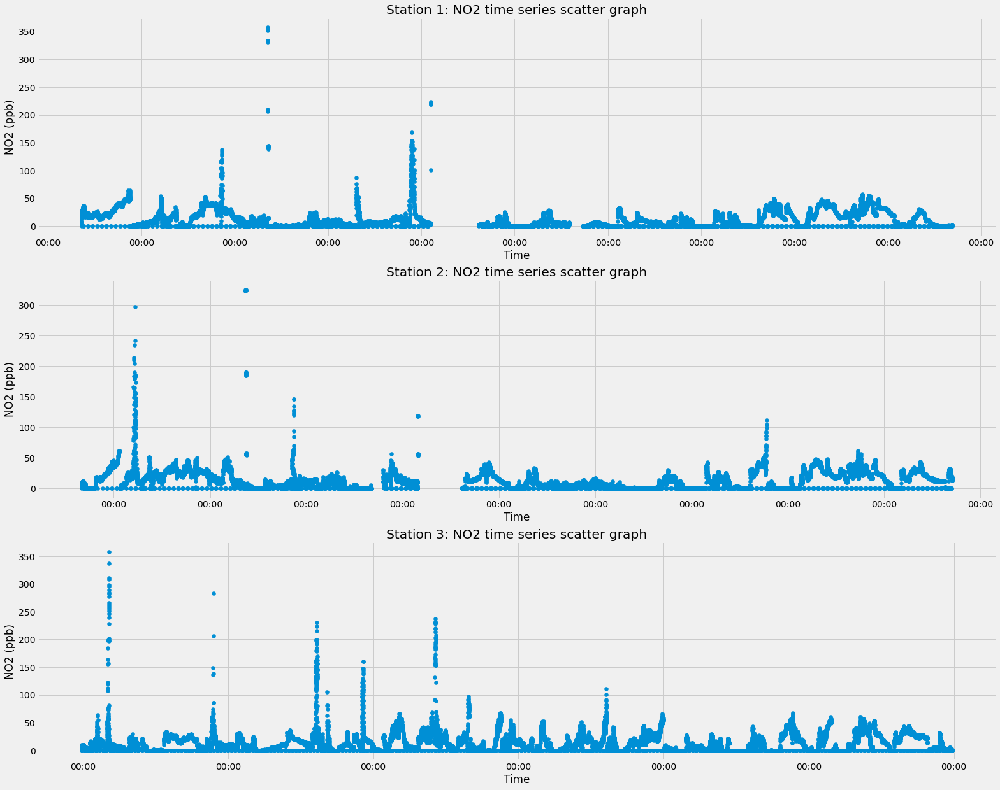

In [15]:
myTimeFormat = mdates.DateFormatter('%H:%M')

plt.style.use('fivethirtyeight')
fig, axs = plt.subplots(3, figsize = (24,20))

axs[0].set_title('Station 1: NO2 time series scatter graph')
axs[0].scatter(x = dfList[0].index, y= dfList[0]["NO2 (ppb)"])
axs[0].set_xlabel("Time")
axs[0].set_ylabel("NO2 (ppb)")
axs[0].xaxis.set_major_formatter(myTimeFormat)

axs[1].set_title('Station 2: NO2 time series scatter graph')
axs[1].scatter(x = dfList[1].index, y= dfList[1]["NO2 (ppb)"])
axs[1].set_xlabel("Time")
axs[1].set_ylabel("NO2 (ppb)")
axs[1].xaxis.set_major_formatter(myTimeFormat)

axs[2].set_title('Station 3: NO2 time series scatter graph')
axs[2].scatter(x = dfList[2].index, y= dfList[2]["NO2 (ppb)"])
axs[2].set_xlabel("Time")
axs[2].set_ylabel("NO2 (ppb)")
axs[2].xaxis.set_major_formatter(myTimeFormat)


plt.show()

# Data Visualisation VOC

<AxesSubplot:xlabel='VOC (ppb)'>

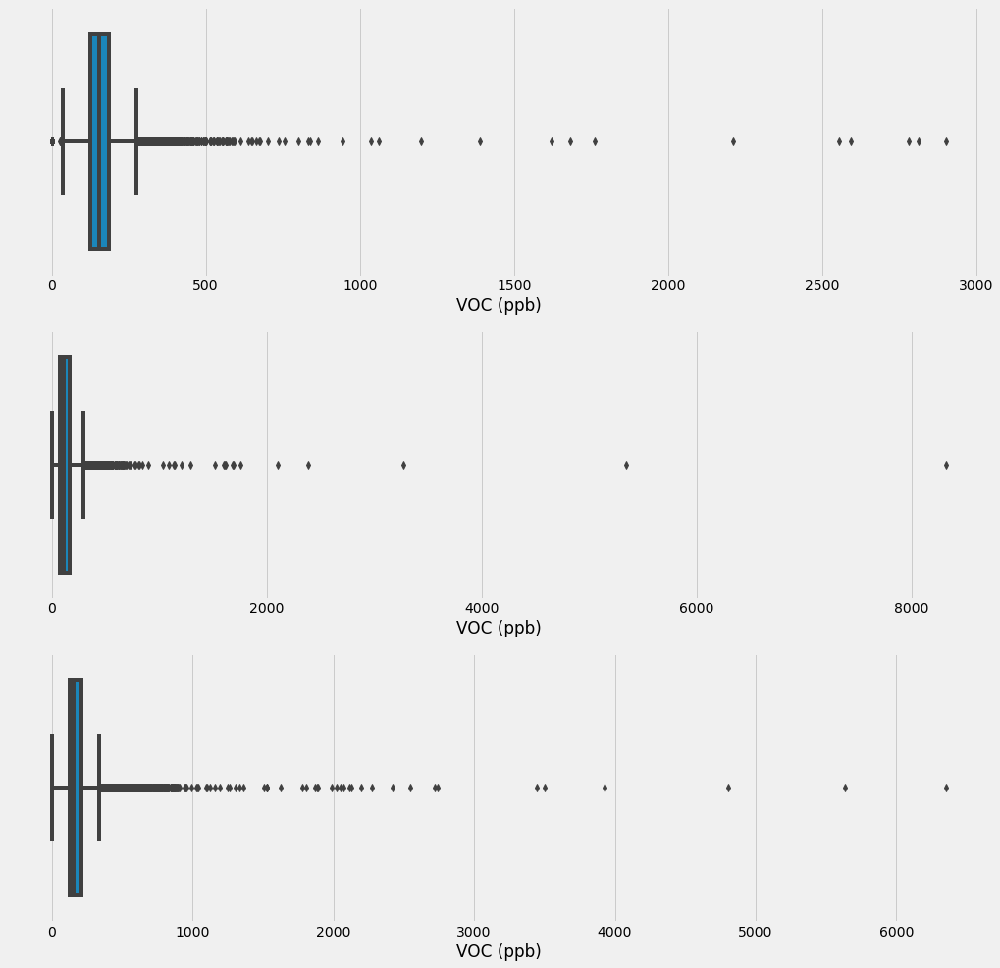

In [16]:
fig, axs = plt.subplots(3, figsize = (16,16))
sns.boxplot(x=dfList[0]['VOC (ppb)'], ax=axs[0])
sns.boxplot(x=dfList[1]['VOC (ppb)'], ax=axs[1])
sns.boxplot(x=dfList[2]['VOC (ppb)'], ax=axs[2])

## Idenifying zero values and other outliers

In [17]:
outliers = np.array(dfList[1]["VOC (ppb)"])
print("There are: " + str(len(outliers[outliers == 0])) + "\n Zero values in this dataset")
print("There are: " + str(len(outliers[outliers < dfList[1].quantile(0.25)["VOC (ppb)"]])) + "\n values below the Lower Quartile in this dataset")
print("There are: " + str(len(outliers[outliers > dfList[1].quantile(0.75)["VOC (ppb)"]])) + "\n values above the Upper Quartile in this dataset")

There are: 194
 Zero values in this dataset
There are: 5839
 values below the Lower Quartile in this dataset
There are: 6023
 values above the Upper Quartile in this dataset


# Time Series Scatter plot VOC

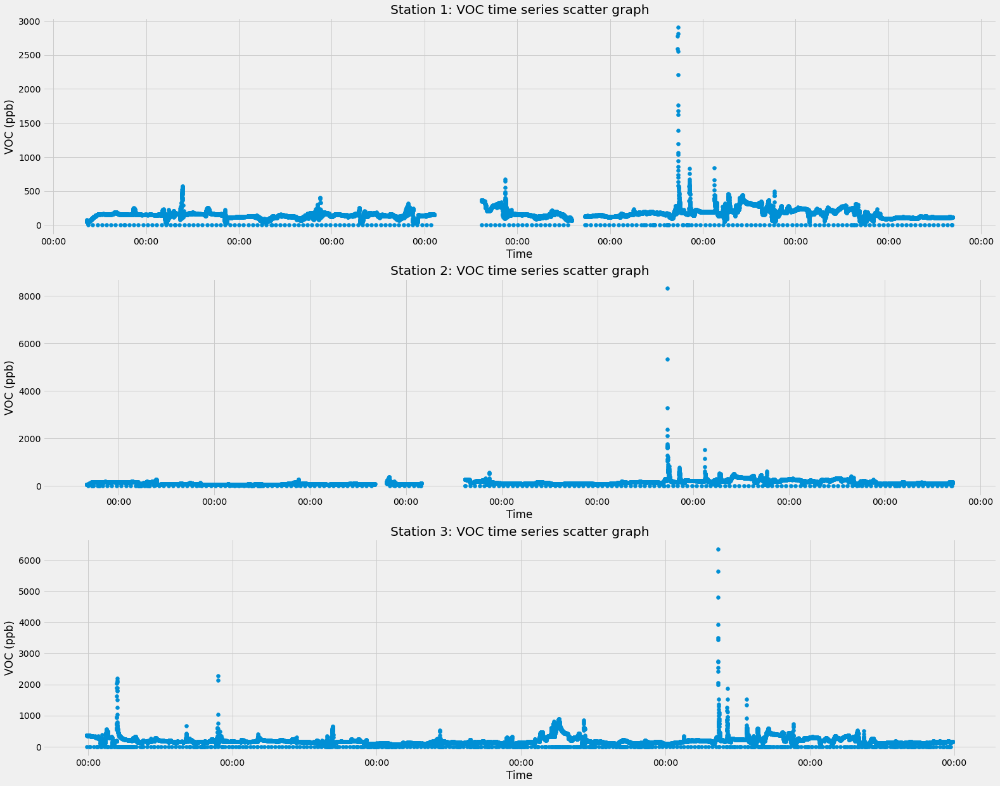

In [18]:
plt.style.use('fivethirtyeight')
fig, axs = plt.subplots(3, figsize = (24,20))

axs[0].set_title('Station 1: VOC time series scatter graph')
axs[0].scatter(x = dfList[0].index, y= dfList[0]["VOC (ppb)"])
axs[0].set_xlabel("Time")
axs[0].set_ylabel("VOC (ppb)")
axs[0].xaxis.set_major_formatter(myTimeFormat)

axs[1].set_title('Station 2: VOC time series scatter graph')
axs[1].scatter(x = dfList[1].index, y= dfList[1]["VOC (ppb)"])
axs[1].set_xlabel("Time")
axs[1].set_ylabel("VOC (ppb)")
axs[1].xaxis.set_major_formatter(myTimeFormat)

axs[2].set_title('Station 3: VOC time series scatter graph')
axs[2].scatter(x = dfList[2].index, y= dfList[2]["VOC (ppb)"])
axs[2].set_xlabel("Time")
axs[2].set_ylabel("VOC (ppb)")
axs[2].xaxis.set_major_formatter(myTimeFormat)

plt.show()

# Data resampling

When there is too much data this begins to look like noise. A simple way to smooth the data is to resample the dataset into a smaller size.

We can take the mean value of ober every minutes of readings as our "smoothed" average of measurements


In [20]:
smoothdf = dfList[0].resample('15min').mean()
smoothdf.head()

,timestamp,NO2 (ppb),NO2 (Plume AQI),VOC (ppb),VOC (Plume AQI),pm 1 (ug/m3),pm 1 (Plume AQI),pm 10 (ug/m3),pm 10 (Plume AQI),pm25 (ug/m3),pm 25 (Plume AQI)
date,,,,,,,,,,,
2021-08-05 17:00:00,1.628183e+09,7.125000,6.500000,61.000000,4.750000,1.250000,3.500000,13.125000,13.125000,2.500000,4.875000
2021-08-05 17:15:00,1.628184e+09,17.866667,17.000000,47.000000,3.933333,2.133333,5.333333,21.400000,22.133333,3.733333,7.400000
2021-08-05 17:30:00,1.628185e+09,27.266667,28.466667,43.466667,3.466667,2.000000,5.266667,24.400000,25.266667,3.533333,6.933333
2021-08-05 17:45:00,1.628186e+09,30.133333,32.600000,42.466667,3.733333,1.466667,3.866667,28.866667,30.933333,3.133333,6.133333
2021-08-05 18:00:00,1.628187e+09,30.000000,33.666667,48.933333,4.000000,1.733333,4.533333,26.666667,27.000000,3.266667,6.600000


In [21]:
#adding ticks to for numerical iteration over the dataset (a secondary index)
smoothdf['id'] = range(0,len(smoothdf.index.values))

model = LinearRegression().fit(smoothdf[["id"]],smoothdf[["VOC (ppb)"]])
m = model.coef_[0]
b = model.intercept_

#equation of regression line 
print ('y = ', round(m[0],2), 'x + ', round(b[0],2))


NameError: name 'LinearRegression' is not defined

In [22]:
predictions = model.predict(smoothdf[["id"]])

# making a DataFrame for the predictions
predictions = pd.DataFrame(data = predictions, index = smoothdf.index.values, columns = ['VOC Pred'])
predictions.head()

NameError: name 'model' is not defined

In [ ]:
joined_df = smoothdf.join(predictions, how = 'inner')
joined_df.head()

In [ ]:
fig = plt.figure(figsize = (24,8))
ax = fig.add_subplot(111)
ax.xaxis.set_major_locator(mdates.HourLocator(interval=3)) #set x interval to hourly
ax.xaxis.set_major_formatter(myTimeFormat) #set format hour:min

ax.plot(joined_df.index, joined_df['VOC (ppb)'], color = (0,0,0), linewidth = 4, alpha = .9, label = 'Smoothed')
ax.plot(joined_df.index, joined_df['VOC Pred'], color = (1,0,0), label = 'Prediction')
ax.set_title('Resampled data vs Linear Regression VOC')
ax.set_xlabel('Time (hours)')
ax.set_ylabel('VOC (ppb)')
ax.legend(loc='lower right')


# PostGreSQL in Jupyter

In [ ]:
#store the dataframe using magic function so that we can use this in a different notebook
#%store dfList